### Running in the TPU will be faster comparing to running in the Local CPU
### Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

<div style="background-color:#E8F8F5; border-left:5px solid #0E6251; padding:15px; margin-bottom:20px; border-radius:5px;">
  <strong style="color:#0E6251;">Importing Libraries:</strong> 
  <ul>
    <li><strong>Data Manipulation:</strong> We use <strong>numpy</strong> for numerical operations and <strong>pandas</strong> for data structure handling.</li>
    <li><strong>Data Visualization:</strong> Interactive plotting is facilitated by <strong>plotly.express</strong>, <strong>plotly.graph_objects</strong>, and <strong>plotly.figure_factory</strong>, alongside <strong>matplotlib.pyplot</strong> for static plotting.</li>
    <li><strong>Natural Language Processing:</strong> The <strong>WordCloud</strong> library generates word clouds, while <strong>langdetect</strong> is used for language detection.</li>
    <li><strong>Reproducibility:</strong> To ensure interactive plots work seamlessly in Jupyter, we initialize the notebook mode with <strong>plotly.offline.init_notebook_mode</strong>.</li>
    <li><strong>Data Preprocessing:</strong> <strong>MinMaxScaler</strong> and <strong>LabelEncoder</strong> are essential for scaling features and encoding categorical variables respectively.</li>
    <li><strong>Model Training:</strong> TensorFlow's flexibility is employed for constructing and training neural network models, while Scikit-learn's <strong>train_test_split</strong> aids in data partitioning.</li>
    <li><strong>Collaborative Filtering:</strong> TensorFlow's <strong>keras</strong> library provides layers like <strong>Embedding</strong> and <strong>Dot</strong> that are key for recommendation systems.</li>
    <li><strong>Content-Based Filtering:</strong> Textual similarity is calculated using <strong>TfidfVectorizer</strong> and <strong>linear_kernel</strong> from Scikit-learn.</li>
  </ul>
</div>


In [1]:
#!pip install plotly

In [2]:
##!pip install wordcloud

In [3]:
#!pip install langdetect

In [4]:
# Reading Dataset
import numpy as np
import pandas as pd
# Visualization
import plotly.express as px
import plotly.graph_objects as go  # for 3D plot visualization
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

from wordcloud import WordCloud
from langdetect import detect
from datetime import datetime

<div style="background-color:#E6EEFF; border-left:5px; padding:15px; margin-bottom:20px; border-radius:5px; text-align:center;">
  <h1 style="color:#3F72AF; margin:0;">Initiating Data Discovery</h1>
</div>


In [5]:
# Setting column display to 50
pd.set_option('display.max_columns', 50)

In [6]:
# Importing anime details dataframe
df_anime=pd.read_csv('AnimeInfo.csv')
print("Shape of the Dataset:",df_anime.shape)
df_anime.head(3)

Shape of the Dataset: (24905, 24)


,anime_id,Name,English name,Other name,Score,Genres,Synopsis,Type,Episodes,Aired,Premiered,Status,Producers,Licensors,Studios,Source,Duration,Rating,Rank,Popularity,Favorites,Scored By,Members,Image URL
0,1,Cowboy Bebop,Cowboy Bebop,カウボーイビバップ,8.75,"Action, Award Winning, Sci-Fi","Crime is timeless. By the year 2071, humanity ...",TV,26.0,"Apr 3, 1998 to Apr 24, 1999",spring 1998,Finished Airing,Bandai Visual,"Funimation, Bandai Entertainment",Sunrise,Original,24 min per ep,R - 17+ (violence & profanity),41.0,43,78525,914193.0,1771505,https://cdn.myanimelist.net/images/anime/4/196...
1,5,Cowboy Bebop: Tengoku no Tobira,Cowboy Bebop: The Movie,カウボーイビバップ 天国の扉,8.38,"Action, Sci-Fi","Another day, another bounty—such is the life o...",Movie,1.0,"Sep 1, 2001",UNKNOWN,Finished Airing,"Sunrise, Bandai Visual",Sony Pictures Entertainment,Bones,Original,1 hr 55 min,R - 17+ (violence & profanity),189.0,602,1448,206248.0,360978,https://cdn.myanimelist.net/images/anime/1439/...
2,6,Trigun,Trigun,トライガン,8.22,"Action, Adventure, Sci-Fi","Vash the Stampede is the man with a $$60,000,0...",TV,26.0,"Apr 1, 1998 to Sep 30, 1998",spring 1998,Finished Airing,Victor Entertainment,"Funimation, Geneon Entertainment USA",Madhouse,Manga,24 min per ep,PG-13 - Teens 13 or older,328.0,246,15035,356739.0,727252,https://cdn.myanimelist.net/images/anime/7/203...


In [7]:
# Importing user details dataframe
df_user=pd.read_csv('UserInfo.csv')
print("Shape of the Dataset:",df_user.shape)
df_user.head()

Shape of the Dataset: (731290, 16)


,Mal ID,Username,Gender,Birthday,Location,Joined,Days Watched,Mean Score,Watching,Completed,On Hold,Dropped,Plan to Watch,Total Entries,Rewatched,Episodes Watched
0,1,Xinil,Male,1985-03-04T00:00:00+00:00,California,2004-11-05T00:00:00+00:00,142.3,7.37,1.0,233.0,8.0,93.0,64.0,399.0,60.0,8458.0
1,3,Aokaado,Male,NaN,"Oslo, Norway",2004-11-11T00:00:00+00:00,68.6,7.34,23.0,137.0,99.0,44.0,40.0,343.0,15.0,4072.0
2,4,Crystal,Female,NaN,"Melbourne, Australia",2004-11-13T00:00:00+00:00,212.8,6.68,16.0,636.0,303.0,0.0,45.0,1000.0,10.0,12781.0
3,9,Arcane,NaN,NaN,NaN,2004-12-05T00:00:00+00:00,30.0,7.71,5.0,54.0,4.0,3.0,0.0,66.0,0.0,1817.0
4,18,Mad,NaN,NaN,NaN,2005-01-03T00:00:00+00:00,52.0,6.27,1.0,114.0,10.0,5.0,23.0,153.0,42.0,3038.0


In [8]:
# Importing user score dataframe
df_score=pd.read_csv('UserScore.csv')
print("Shape of the dataset:",df_score.shape)
df_score.head()

Shape of the dataset: (24325191, 5)


,user_id,Username,anime_id,Anime Title,rating
0,1,Xinil,21,One Piece,9
1,1,Xinil,48,.hack//Sign,7
2,1,Xinil,320,A Kite,5
3,1,Xinil,49,Aa! Megami-sama!,8
4,1,Xinil,304,Aa! Megami-sama! Movie,8


<div style="background-color:#F4F4F4; border-left:5px solid #2C3E50; padding:20px; margin-bottom:20px; border-radius:8px;">

<h1 style="color:#2C3E50;">Exploratory Data Analysis</h1>
<h2 style="color:#34495E;">Data Exploration</h2>

<h4 style="color:#16A085; margin-top:20px;">Checking each dataframe</h4>
<p style="font-size:16px; font-family: 'Helvetica Neue', Helvetica, Arial, sans-serif; color:#2C3E50;">
In order to gain a better understanding of the data, it is important to examine each DataFrame individually. This includes assessing its structure and identifying any missing values. We will begin this process by using the <code>info()</code> method, which provides a comprehensive overview of the DataFrame's columns and structure.
</p>

</div>


In [9]:
df_anime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24905 entries, 0 to 24904
Data columns (total 24 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   anime_id      24905 non-null  int64 
 1   Name          24905 non-null  object
 2   English name  24905 non-null  object
 3   Other name    24905 non-null  object
 4   Score         24905 non-null  object
 5   Genres        24905 non-null  object
 6   Synopsis      24905 non-null  object
 7   Type          24905 non-null  object
 8   Episodes      24905 non-null  object
 9   Aired         24905 non-null  object
 10  Premiered     24905 non-null  object
 11  Status        24905 non-null  object
 12  Producers     24905 non-null  object
 13  Licensors     24905 non-null  object
 14  Studios       24905 non-null  object
 15  Source        24905 non-null  object
 16  Duration      24905 non-null  object
 17  Rating        24905 non-null  object
 18  Rank          24905 non-null  object
 19  Popu

In [10]:
# Preprocessing Score column
df_anime['Score'].value_counts()

Score
UNKNOWN    9213
6.31         80
6.54         80
6.25         79
6.51         79
           ... 
3.21          1
3.29          1
1.85          1
3.69          1
4.07          1
Name: count, Length: 567, dtype: int64

In [11]:
scores = df_anime['Score'][df_anime['Score'] != 'UNKNOWN']
scores = scores.astype('float')
score_mean= round(scores.mean() , 2)

In [12]:
df_anime['Score'] = df_anime['Score'].replace('UNKNOWN', score_mean)
df_anime['Score'] = df_anime['Score'].astype('float64')

In [13]:
# Processing Ranked column
df_anime['Rank'].value_counts()

Rank
UNKNOWN    4612
0.0         187
6542.0        4
16675.0       4
6577.0        4
           ... 
18424.0       1
18423.0       1
11642.0       1
8977.0        1
14536.0       1
Name: count, Length: 15198, dtype: int64

In [14]:
df_anime['Rank'] = df_anime['Rank'].replace('UNKNOWN', np.nan)
df_anime['Rank'] = df_anime['Rank'].astype('float64')

In [15]:
df_user.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 731290 entries, 0 to 731289
Data columns (total 16 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Mal ID            731290 non-null  int64  
 1   Username          731289 non-null  object 
 2   Gender            224383 non-null  object 
 3   Birthday          168068 non-null  object 
 4   Location          152805 non-null  object 
 5   Joined            731290 non-null  object 
 6   Days Watched      731282 non-null  float64
 7   Mean Score        731282 non-null  float64
 8   Watching          731282 non-null  float64
 9   Completed         731282 non-null  float64
 10  On Hold           731282 non-null  float64
 11  Dropped           731282 non-null  float64
 12  Plan to Watch     731282 non-null  float64
 13  Total Entries     731282 non-null  float64
 14  Rewatched         731282 non-null  float64
 15  Episodes Watched  731282 non-null  float64
dtypes: float64(10), int6

In [16]:
df_score.isnull().sum()

user_id          0
Username       232
anime_id         0
Anime Title      0
rating           0
dtype: int64

<div style="background-color:#F4F4F4; border-left:5px solid #2C3E50; padding:20px; margin-bottom:20px; border-radius:8px;">

<h1 style="color:#2C3E50;">Data Visualization Analysis</h1>
<h2 style="color:#34495E;">Data Visualization</h2>

<h4 style="color:#AF7AC5; margin-top:20px;">Making Various Plots</h4>
<p style="font-size:16px; font-family: 'Helvetica Neue', Helvetica, Arial, sans-serif; color:#2C3E50;">
Visual representations of data are essential for understanding complex datasets and uncovering underlying patterns. In this section, we will employ various plotting libraries to create informative and interactive charts that will help in the interpretation of our data's key metrics and trends.
</p>
</div>

### For Anime Dataset

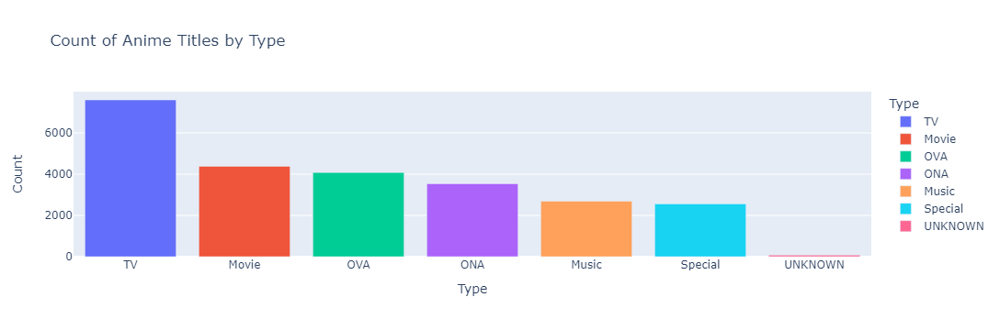

In [17]:
# Count the number of anime titles by type
type_counts = df_anime['Type'].value_counts()

# Create a bar chart
fig = px.bar(type_counts, x=type_counts.index, y=type_counts.values, color=type_counts.index, labels={'x':'Anime Type', 'y':'Count'}, 
             title='Count of Anime Titles by Type')

fig.show()

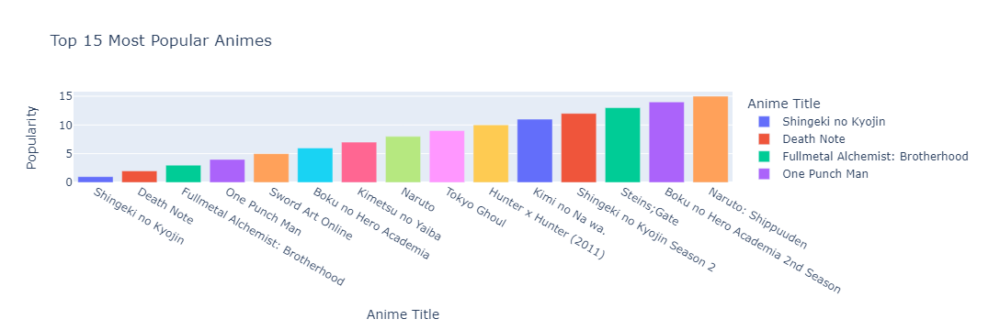

In [18]:
# Filter out anime titles with popularity value 0
df_valid_popularity = df_anime[df_anime['Popularity'] > 0]

# Sort the dataframe by popularity and select the top 15
top_10_popular = df_valid_popularity.sort_values(by='Popularity', ascending=True).head(15)

# Create a bar chart with different colors for each bar
fig = px.bar(top_10_popular, x='Name', y='Popularity',
             labels={'Name': 'Anime Title', 'Popularity': 'Popularity'},
             title='Top 15 Most Popular Animes',
             color='Name')
# Note:- Less the popularity no. is more popular is the anime.
fig.show()

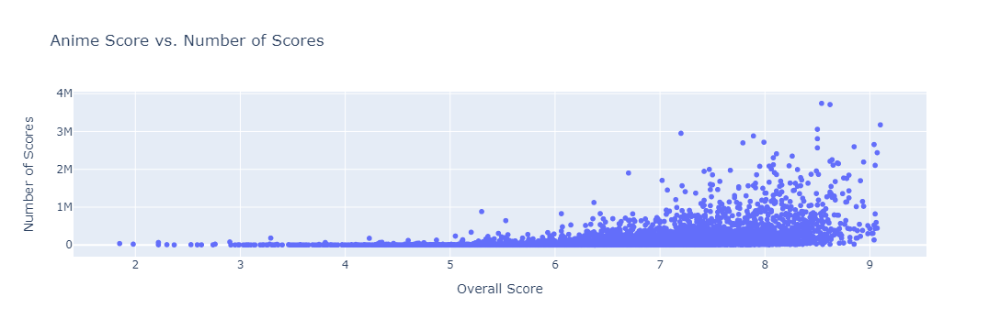

In [19]:
# Create a scatter plot
fig = px.scatter(df_anime, x='Score', y='Members', 
                 labels={'Score':'Overall Score', 'Members':'Number of Scores'}, 
                 title='Anime Score vs. Number of Scores')

fig.show()

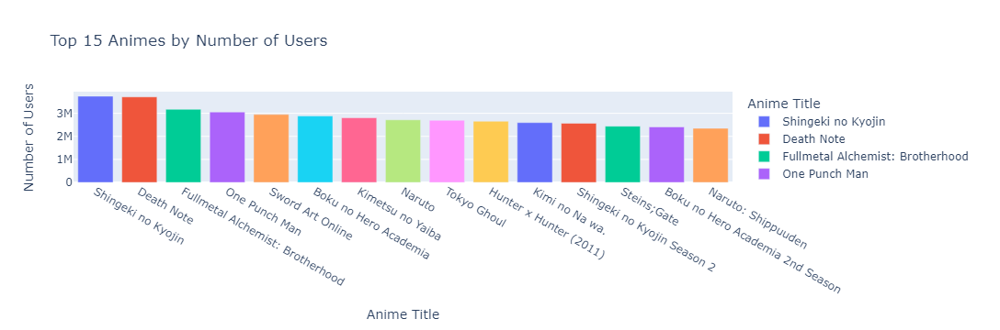

In [20]:
# Sort the dataframe by the number of users who have scored the anime
top_15_scored = df_anime.sort_values(by='Members', ascending=False).head(15)

# Create a bar chart
fig = px.bar(top_15_scored, x='Name', y='Members', labels={'Members':'Number of Users', 'Name':'Anime Title'},color='Name',
             title='Top 15 Animes by Number of Users')

fig.show()

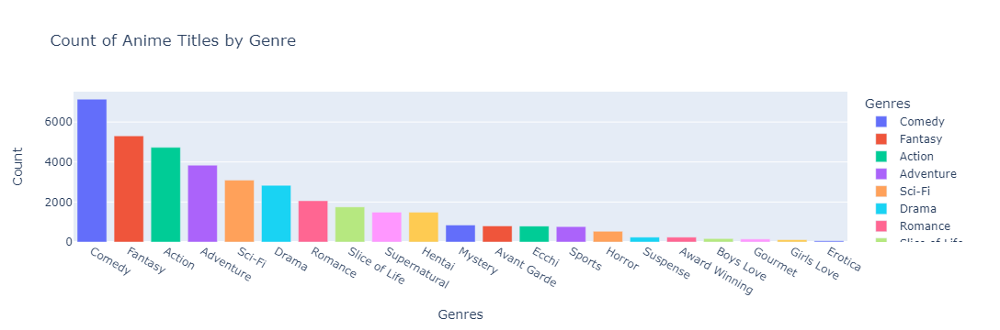

In [21]:
# Split the genres and count their occurrences
genre_counts = df_anime[df_anime['Genres'] != "UNKNOWN"]['Genres'].apply(lambda x: x.split(', ')).explode().value_counts()

# Create a bar chart
fig = px.bar(genre_counts, x=genre_counts.index, y=genre_counts.values,
             labels={'x':'Genre', 'y':'Count'},
             title='Count of Anime Titles by Genre',
             color=genre_counts.index)

fig.show()

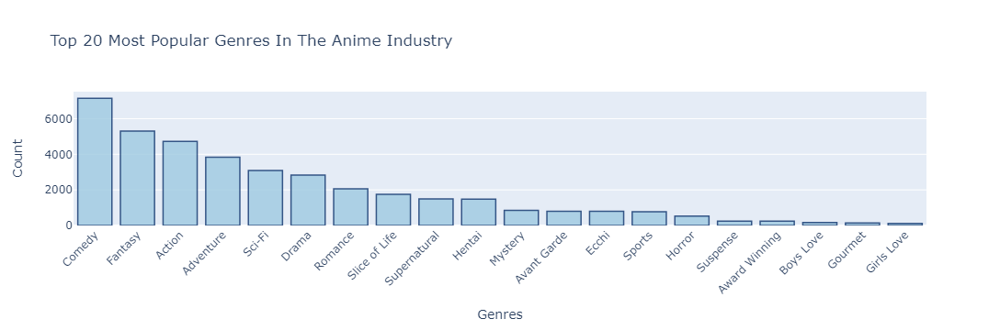

In [22]:
# Select the top 20 genres
top_20_genres = genre_counts.head(20)

# Create a bar chart with custom style
fig = px.bar(top_20_genres, x=top_20_genres.index, y=top_20_genres.values,
             labels={'x':'Genre', 'y':'Count'},
             title='Top 20 Most Popular Genres In The Anime Industry')

# Customize the bar chart appearance
fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.8)

fig.update_layout(xaxis_tickangle=-45, xaxis=dict(tickfont=dict(size=12)),
                  yaxis=dict(titlefont=dict(size=14)))

fig.show()

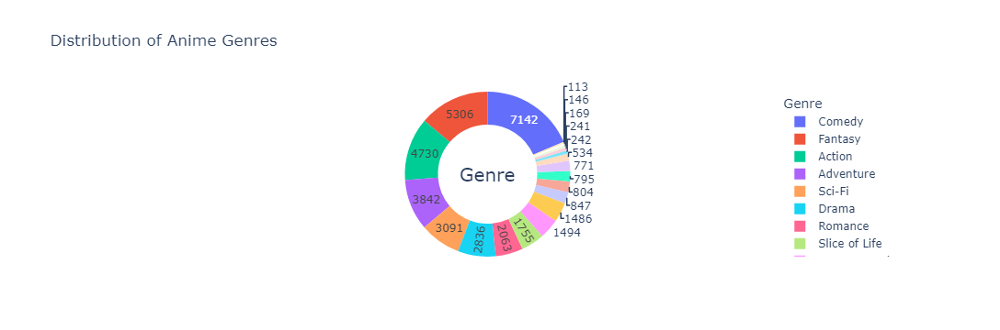

In [23]:
# Create the plotly figure
fig = go.Figure(data=[go.Pie(labels=top_20_genres.index, values=top_20_genres.values,
                             hole=0.6, hoverinfo='label+percent', textinfo='value')])

fig.update_layout(title='Distribution of Anime Genres',
                  legend=dict(font=dict(size=12), title='Genre'),
                  annotations=[dict(text='Genre', x=0.5, y=0.5, font_size=20, showarrow=False)])

fig.show()

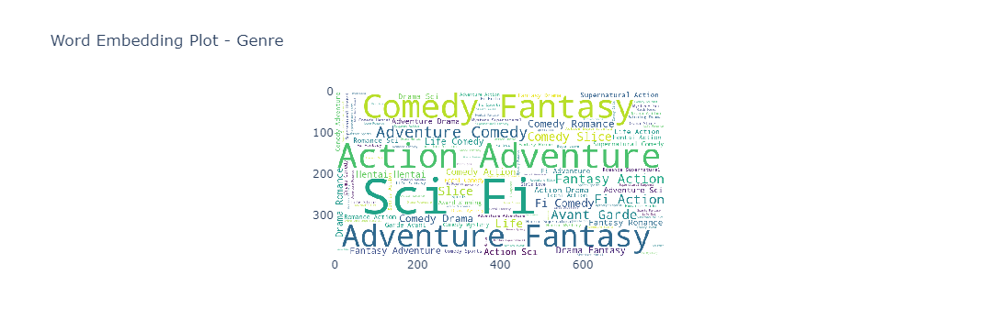

In [24]:
# Concatenate all genre values into a single string
genre_text = ' '.join(df_anime[df_anime['Genres'] != "UNKNOWN"]['Genres'].dropna())

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(genre_text)

# Convert the WordCloud object to an image
wordcloud_image = wordcloud.to_image()

# Create a Plotly figure to display the WordCloud image
fig = go.Figure(go.Image(z=wordcloud_image))
fig.update_layout(title='Word Embedding Plot - Genre')
fig.show()

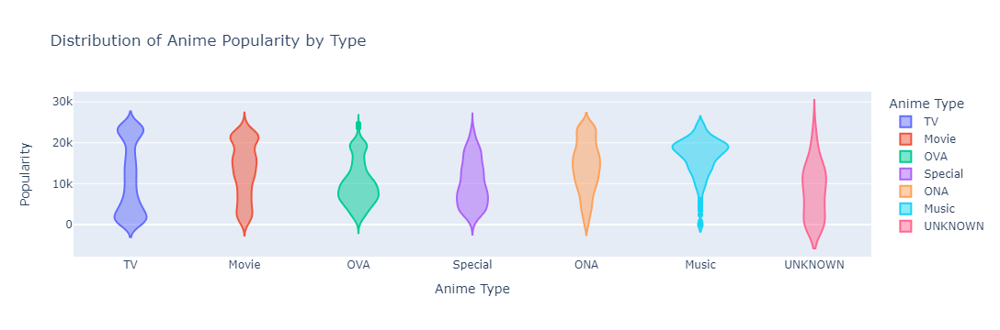

In [25]:
# Create a violin plot for anime popularity by type
fig = px.violin(df_anime, x='Type', y='Popularity', 
                labels={'Type':'Anime Type', 'Popularity':'Popularity'},
                title='Distribution of Anime Popularity by Type',
                color='Type')

fig.show()

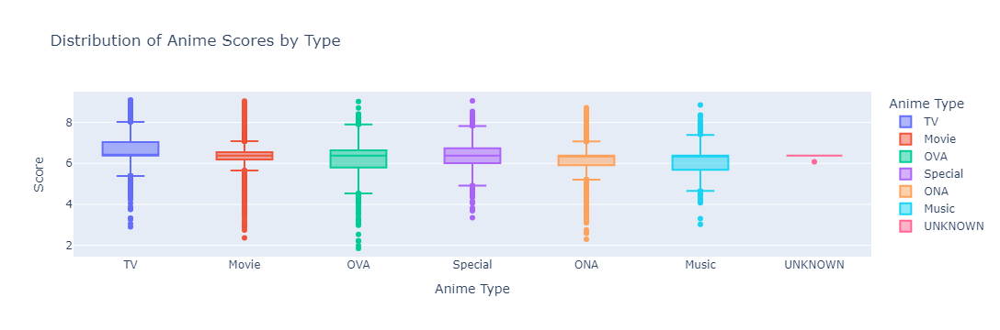

In [26]:
# Create a box plot for anime scores by type
fig = px.box(df_anime, x='Type', y='Score', 
             labels={'Type':'Anime Type', 'Score':'Score'},
             title='Distribution of Anime Scores by Type',
             color='Type')

fig.show()

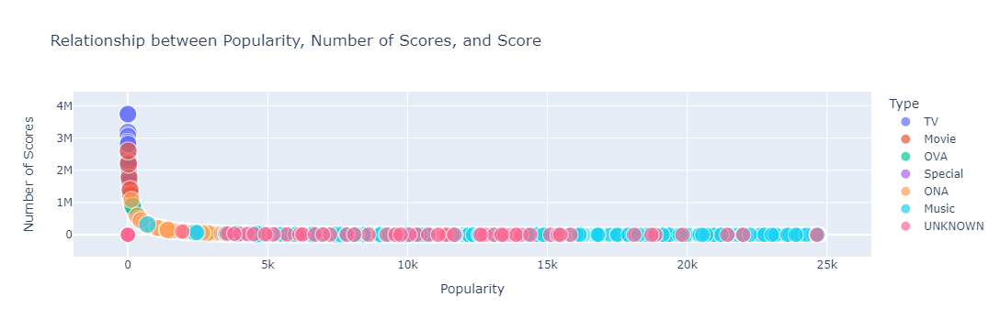

In [27]:
# Create a bubble chart to visualize the relationship between popularity and scored_by
fig = px.scatter(df_anime, x='Popularity', y='Members', size='Score', color='Type',
                 labels={'Popularity':'Popularity', 'Members':'Number of Scores'},
                 title='Relationship between Popularity, Number of Scores, and Score')

fig.show()

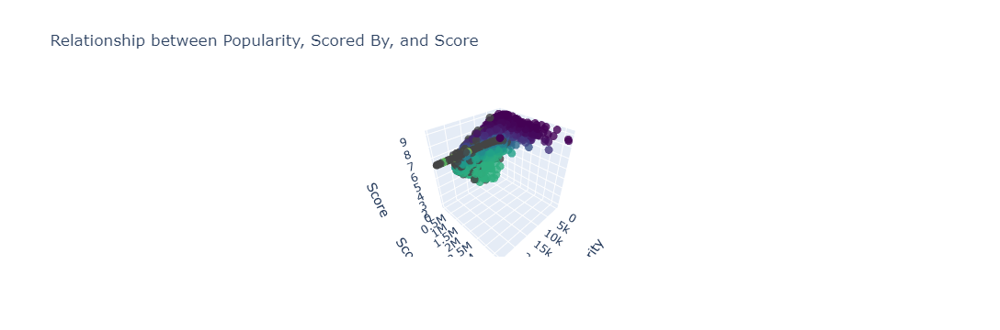

In [28]:
# Create a 3D scatter plot to visualize the relationship between popularity, scored_by, and score
fig = go.Figure(data=go.Scatter3d(
    x=df_anime['Popularity'],
    y=df_anime['Members'],
    z=df_anime['Score'],
    mode='markers',
    marker=dict(
        size=5,
        color=df_anime['Rank'],
        colorscale='Viridis',
        opacity=0.8
    ),
    text=df_anime['Name'],
    hovertemplate='<b>Title</b>: %{text}<br><b>Popularity</b>: %{x}<br><b>Scored By</b>: %{y}<br><b>Score</b>: %{z}',
))

fig.update_layout(scene=dict(
    xaxis_title='Popularity',
    yaxis_title='Scored By',
    zaxis_title='Score'
), title='Relationship between Popularity, Scored By, and Score')

fig.show()

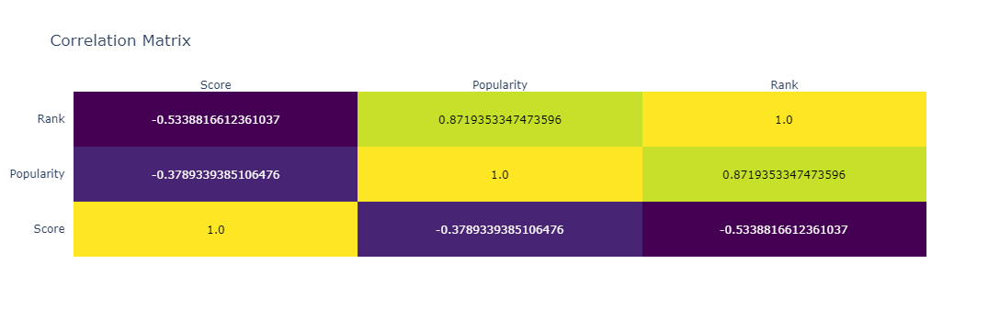

In [29]:
# Create a correlation matrix
correlation_matrix = df_anime[['Score', 'Popularity', 'Rank']].corr()

# Create a heatmap of the correlation matrix
fig = ff.create_annotated_heatmap(z=correlation_matrix.values,
                                  x=list(correlation_matrix.columns),
                                  y=list(correlation_matrix.index),
                                  colorscale='Viridis')
fig.update_layout(title='Correlation Matrix')
fig.show()

In [30]:
df_anime['Licensors'].value_counts()

Licensors
UNKNOWN                                                                  20170
Funimation                                                                 957
Sentai Filmworks                                                           818
Discotek Media                                                             275
Aniplex of America                                                         222
                                                                         ...  
Bandai Entertainment, Maiden Japan                                           1
ADV Films, SoftCel Pictures                                                  1
VIZ Media, Media Blasters, Sentai Filmworks, Geneon Entertainment USA        1
Bandai Entertainment, Discotek Media, NYAV Post, Bandai Visual USA           1
Bandai Namco Online                                                          1
Name: count, Length: 265, dtype: int64

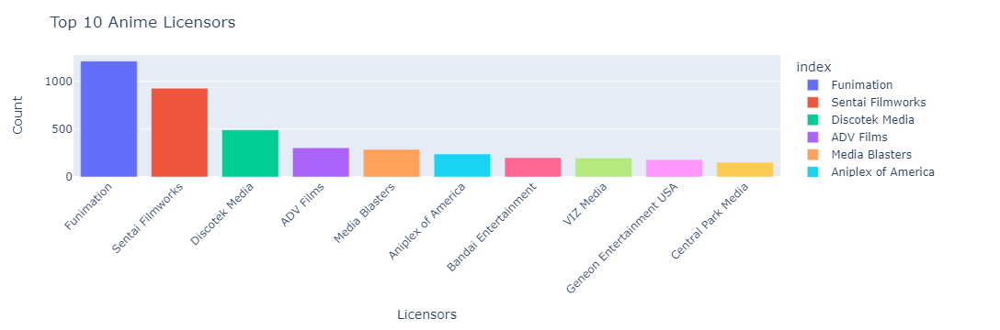

In [31]:
# Create a list of all the individual licensors
licensors_list = [licensor.strip() for licensors in df_anime[df_anime['Licensors']!="UNKNOWN"]['Licensors'].str.split(',') for licensor in licensors]

# Count the occurrences of each licensor
licensor_counts = pd.Series(licensors_list).value_counts()

# Filter the licensor_counts series to exclude 'Unknown'
filtered_licensor_counts = licensor_counts[licensor_counts.index != 'Unknown']

# Select the top 10 licensors
top_15_licensors = filtered_licensor_counts.head(10)

# Create the bar plot using Plotly
fig = px.bar(top_15_licensors, x=top_15_licensors.index, y=top_15_licensors.values, color=top_15_licensors.index)

# Customize the plot
fig.update_layout(
    title='Top 10 Anime Licensors',
    xaxis_title='Licensors',
    yaxis_title='Count',
    xaxis_tickangle=-45
)

# Show the plot
fig.show()

In [32]:
df_anime['Premiered'].value_counts()

Premiered
UNKNOWN        19399
spring 2017       88
fall 2016         83
spring 2018       81
spring 2016       78
               ...  
summer 1993        1
summer 1974        1
summer 1991        1
spring 1961        1
summer 2025        1
Name: count, Length: 244, dtype: int64

In [33]:
# Function to extract the season and year from the premiered string
def extract_season_year(premiered):
    if premiered == 'UNKNOWN':
        return None, None
    else:
        season, year = premiered.split()
        return season, int(year)

# Apply the function to extract the season and year from the "Premiered" column
season_year = df_anime['Premiered'].map(extract_season_year)
premiered_season = season_year.apply(lambda x: x[0])
premiered_Year = season_year.apply(lambda x: x[1])

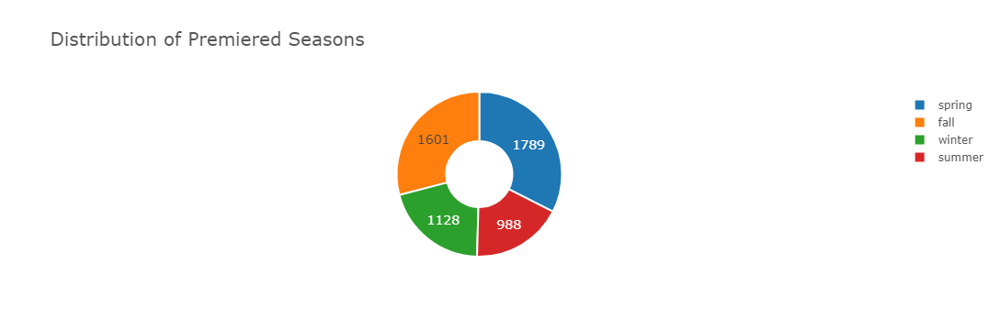

In [34]:
# Filter out None values from premiered_season
filtered_premiered_season = premiered_season.dropna()

# Count the occurrences of each season
season_counts = filtered_premiered_season.value_counts()

# Create the pie plot
fig = go.Figure(data=go.Pie(
    labels=season_counts.index,
    values=season_counts.values,
    hole=0.4,  # Add a donut hole in the center
    hoverinfo='label+percent',  # Display label and percentage on hover
    textinfo='value',  # Display count value as text inside each slice
    textfont=dict(size=14),  # Set the text font size
    marker=dict(
        colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd'],  # Custom color palette
        line=dict(color='#ffffff', width=2)  # Set the color and width of the slice borders
    )
))

# Set the title and font style for the plot
fig.update_layout(
    title='Distribution of Premiered Seasons',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

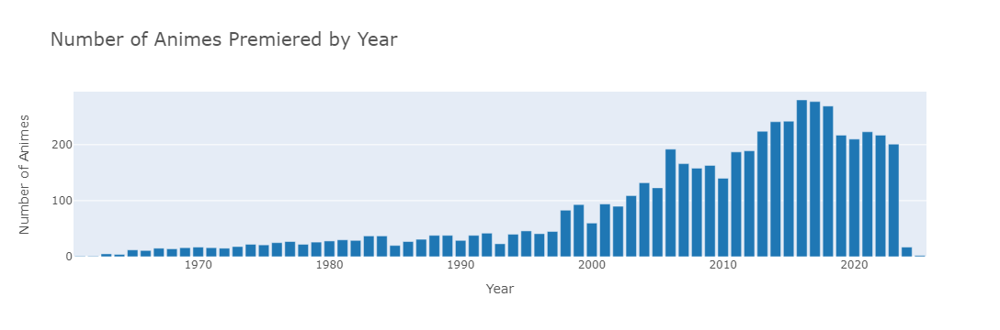

In [35]:
# Filter out None values from premiered_Year
filtered_premiered_year = premiered_Year.dropna()

# Count the occurrences of each year
year_counts = filtered_premiered_year.value_counts()

# Sort the years in ascending order
sorted_years = sorted(year_counts.index)

# Create the bar plot
fig = go.Figure(data=go.Bar(
    x=sorted_years,
    y=year_counts[sorted_years],
    marker=dict(color='#1f77b4'),  # Set the color of the bars
))

# Set the title and axis labels
fig.update_layout(
    title='Number of Animes Premiered by Year',
    xaxis_title='Year',
    yaxis_title='Number of Animes',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

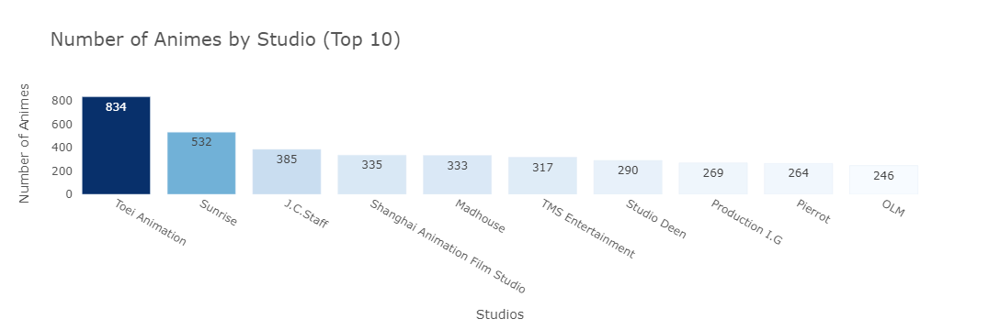

In [36]:
# Count the occurrences of each studio
studio_counts = df_anime['Studios'].value_counts()

# Filter the studio_counts series to exclude 'Unknown'
studio_counts = studio_counts[studio_counts.index != 'UNKNOWN']

# Select the top 10 studios with the highest number of animes
top_studios = studio_counts.head(10)

# Create the bar plot
fig = go.Figure(data=go.Bar(
    x=top_studios.index,
    y=top_studios.values,
    marker=dict(color=top_studios.values, colorscale='Blues'),  # Set the color of the bars using a colorscale
    text=top_studios.values,  # Set the text to be displayed on hover
    hovertemplate='Studio: %{x}<br>Number of Animes: %{y}<extra></extra>',  # Customize the hover template
))

# Set the title and axis labels
fig.update_layout(
    title='Number of Animes by Studio (Top 10)',
    xaxis_title='Studios',
    yaxis_title='Number of Animes',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555'),
    plot_bgcolor='rgba(0, 0, 0, 0)'  # Set the background color to transparent
)

fig.show()

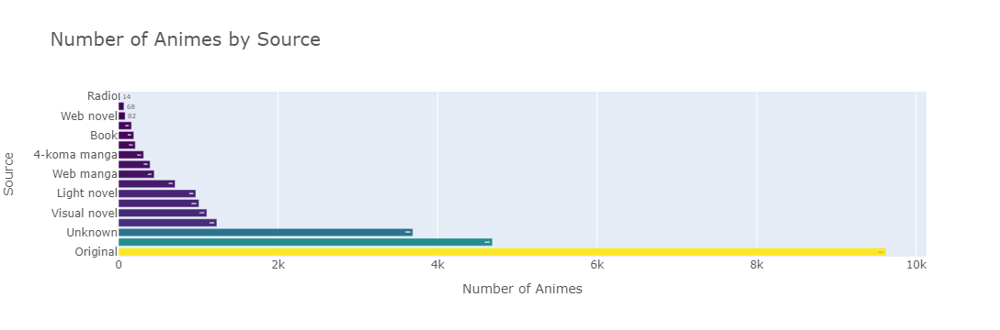

In [37]:
# Count the occurrences of each source
source_counts = df_anime['Source'].value_counts()

# Filter the source_counts series to exclude 'Unknown'
source_counts = source_counts[source_counts.index != 'UNKNOWN']

# Create the horizontal bar chart
fig = go.Figure(data=go.Bar(
    x=source_counts.values,
    y=source_counts.index,
    orientation='h',  # Set the orientation to horizontal
    marker=dict(color=source_counts.values, colorscale='Viridis'),  # Set the color of the bars using a colorscale
    text=source_counts.values,  # Set the text to be displayed on hover
    hovertemplate='Source: %{y}<br>Number of Animes: %{x}<extra></extra>',  # Customize the hover template
))

# Set the title and axis labels
fig.update_layout(
    title='Number of Animes by Source',
    xaxis_title='Number of Animes',
    yaxis_title='Source',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

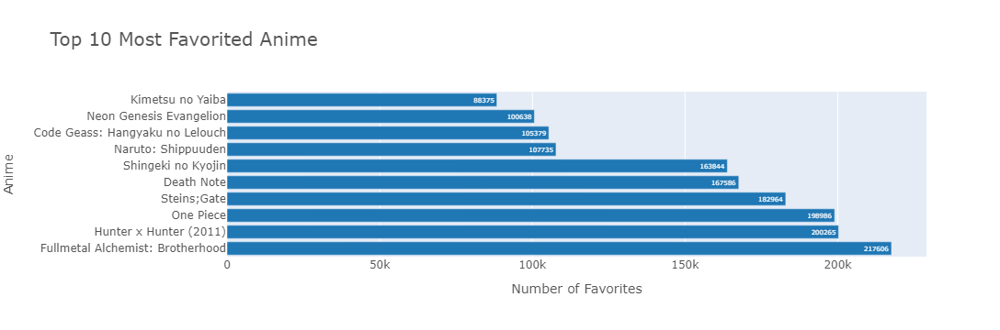

In [38]:
# Sort the DataFrame by the 'Favorites' column in descending order
sorted_df = df_anime.sort_values('Favorites', ascending=False)

# Select the top 10 most favorited anime
top_favorites = sorted_df.head(10)

# Create the horizontal bar chart
fig = go.Figure(data=go.Bar(
    x=top_favorites['Favorites'],
    y=top_favorites['Name'],
    orientation='h',  # Set the orientation to horizontal
    marker=dict(color='#1f77b4'),  # Set the color of the bars
    text=top_favorites['Favorites'],  # Set the text to be displayed on hover
    hovertemplate='Anime: %{y}<br>Favorites: %{x}<extra></extra>',  # Customize the hover template
))

# Set the title and axis labels
fig.update_layout(
    title='Top 10 Most Favorited Anime',
    xaxis_title='Number of Favorites',
    yaxis_title='Anime',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

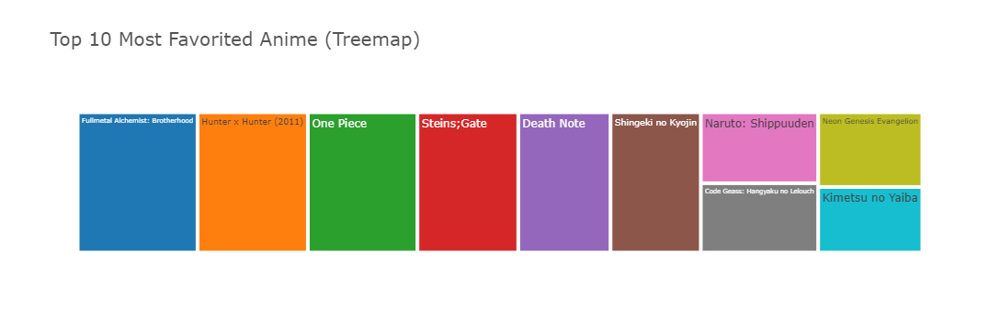

In [39]:
# Creating the treemap plot too fr the above code snippet
fig = go.Figure(go.Treemap(
    labels=top_favorites['Name'],
    parents=[""] * len(top_favorites),
    values=top_favorites['Favorites'],
    hovertemplate='Name: %{label}<br>Favorites: %{value}',
))

# Set the color scale
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
          '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
fig.update_traces(marker=dict(colors=colors))

# Set the title
fig.update_layout(
    title='Top 10 Most Favorited Anime (Treemap)',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555'),
)

fig.show()

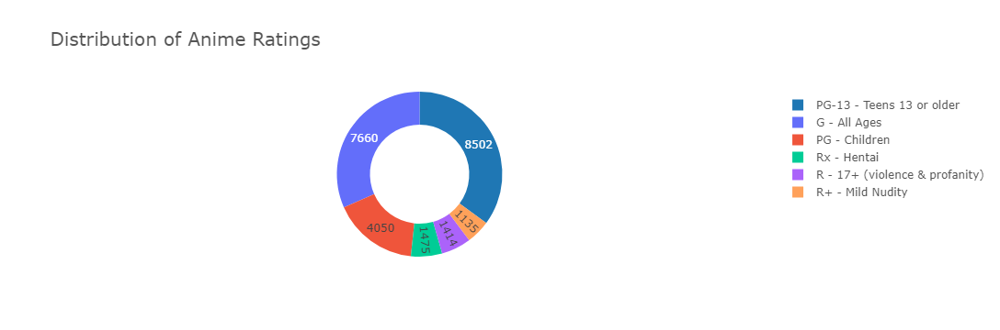

In [40]:
# Count the occurrences of each rating
rating_counts = df_anime[df_anime['Rating']!="UNKNOWN"]['Rating'].value_counts()

# Filter the rating_counts series to exclude 'Unknown'
rating_counts = rating_counts[rating_counts.index != 'Unknown']

# Create the pie plot
fig = go.Figure(data=go.Pie(
    labels=rating_counts.index,
    values=rating_counts.values,
    hoverinfo='label+percent',
    textinfo='value',
    textfont=dict(size=12),
    marker=dict(colors=['#1f77b4']),  # Set the same color for all segments
    hole=0.6,  # Set the size of the inner hole to create a donut shape
))

# Set the title
fig.update_layout(
    title='Distribution of Anime Ratings',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555'),
)

fig.show()

In [41]:
# Function to map abbreviated language codes to full names
def map_language_code(code):
    language_mapping = {
        'ja': 'Japanese',
        'ko': 'Korean',
        'zh-cn': 'Simplified Chinese',
        'de': 'German',
        'vi': 'Vietnamese',
        'en': 'English',
        'zh-tw': 'Traditional Chinese'
    }
    return language_mapping.get(code, 'Other')

# Function to detect language
def detect_language(name):
    try:
        return detect(name)
    except:
        return None  # Return None for rows where detection fails

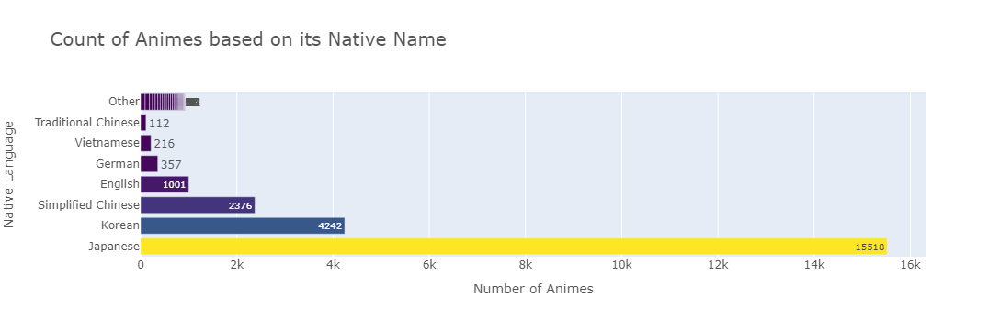

In [42]:
# Apply language detection to the 'Other name' column
Detected_Language = df_anime[df_anime['Other name']!="UNKNOWN"]['Other name'].apply(detect_language)

# Drop rows where language detection failed (i.e., where Detected_Language is None)
Detected_Language = Detected_Language.dropna()

# Count the occurrences of each language
language_counts = Detected_Language.value_counts()

# Map abbreviated language codes to full names for plotting
language_counts.index = language_counts.index.map(map_language_code)

fig = go.Figure(data=go.Bar(
    x=language_counts.values,
    y=language_counts.index,
    orientation='h',
    marker=dict(color=language_counts.values, colorscale='Viridis'),
    text=language_counts.values,  # Set the text to be displayed on hover
    hovertemplate='Native Language: %{y}<br>Number of Animes: %{x}<extra></extra>',
))

# Set the title and axis labels
fig.update_layout(
    title='Count of Animes based on its Native Name',
    xaxis_title='Number of Animes',
    yaxis_title='Native Language',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

### For User Dataset

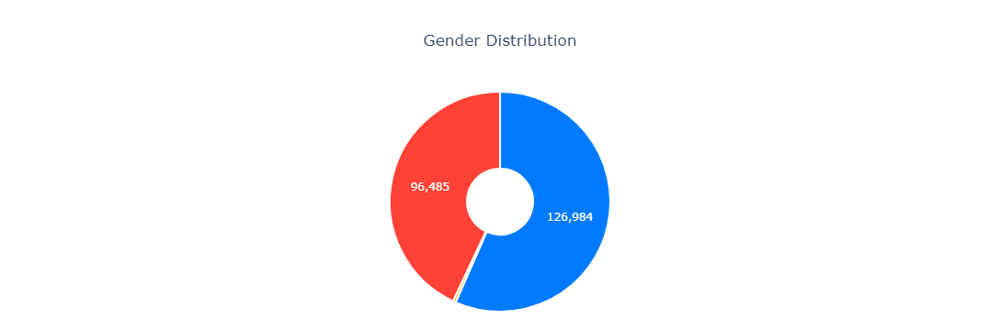

In [43]:
# Distribution of gender
# Count the occurrences of each gender
gender_counts = df_user['Gender'].value_counts(dropna=True)

# Define custom colors for the pie slices
colors = ['rgb(0, 123, 255)', 'rgb(255, 65, 54)', 'rgb(255, 187, 0)', 'rgb(125, 125, 125)']

# Create the pie plot
fig = go.Figure()

fig.add_trace(go.Pie(
    labels=gender_counts.index,
    values=gender_counts.values,
    hole=0.3,
    marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)),
    hoverinfo='label+percent',
    hovertemplate='<b>%{label}</b><br>%{percent}',
    textinfo='value',
    textposition='inside',
    sort=False
))

# Customize the layout
fig.update_layout(
    title='Gender Distribution',
    title_x=0.5,
    uniformtext_minsize=12,
    uniformtext_mode='hide',
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=20, r=20, t=100, b=20),
)

# Show the plot
fig.show()

In [44]:
df_user['Birthday'].value_counts(dropna=True)

Birthday
1990-01-01T00:00:00+00:00    177
1989-03-26T00:00:00+00:00    169
1980-01-01T00:00:00+00:00    166
1930-01-01T00:00:00+00:00    153
1991-01-01T00:00:00+00:00    115
                            ... 
1966-12-06T00:00:00+00:00      1
2001-11-08T00:00:00+00:00      1
1954-10-16T00:00:00+00:00      1
1958-03-13T00:00:00+00:00      1
2000-10-13T00:00:00+00:00      1
Name: count, Length: 11247, dtype: int64

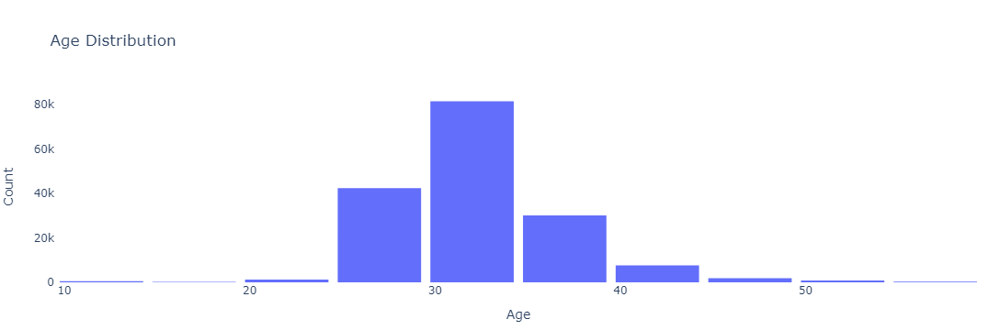

In [45]:
# Age Distribution
# Convert birthday to age
def calculate_age(birth_date):
    if birth_date != 'NaN':
        try:
            birth_year = int(birth_date.split('-')[0])
            today_year = datetime.utcnow().year
            age = today_year - birth_year
            if age >= 10 and age < 60:  # Valid age range (modify as needed)
                return age
            else:
                return None
        except:
            return None
    return None

# Apply age calculation to the 'Birthday' column
Age = df_user['Birthday'].dropna().apply(calculate_age)

# Create the histogram
fig = px.histogram(Age, nbins=20, title='Age Distribution', labels={'value': 'Age', 'count': 'Count'})

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Age'),
    yaxis=dict(title='Count'),
    bargap=0.1,
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=50, r=20, t=100, b=50),
)

# Show the plot
fig.show()

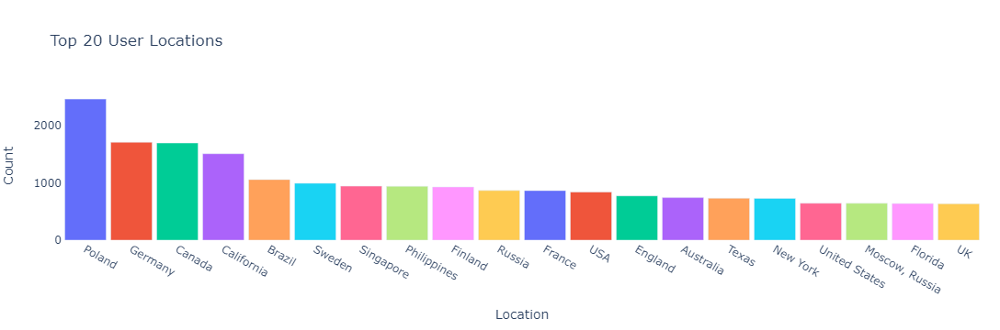

In [46]:
# Location analysis
# Count the occurrences of each location
location_counts = df_user['Location'].value_counts()

# Create a bar chart
fig = px.bar(location_counts.head(20),
             x=location_counts.head(20).index,
             y=location_counts.head(20).values,
             labels={'x': 'Location', 'y': 'Count'},
             title='Top 20 User Locations',
             color=location_counts.head(20).index)

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Location'),
    yaxis=dict(title='Count'),
    bargap=0.1,
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=50, r=20, t=100, b=50),
)

# Show the plot
fig.show()

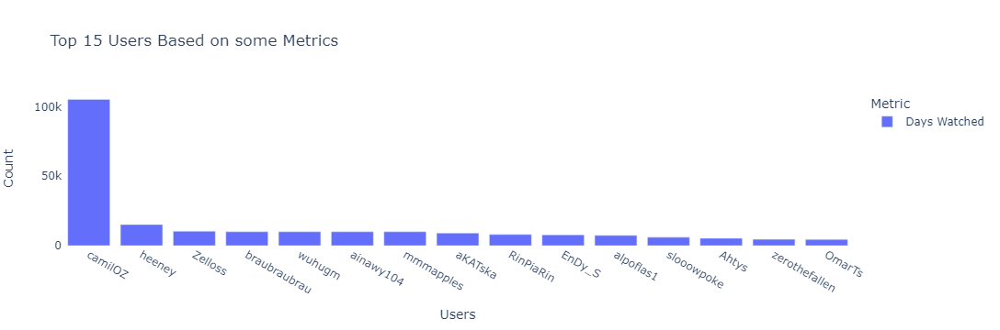

In [47]:
# Define the metrics you want to consider for top users
metrics = ['Days Watched']
# You can change the metrics to 'Mean Score', 'Watching', 'Completed', 'On Hold', 'Dropped', 'Plan to Watch' or include
# a combination of them to see the comparison b/w them such as Watching vs. Completed

# Initialize an empty DataFrame to store the top users
top_users = pd.DataFrame()

for metric in metrics:
    top_users = pd.concat([top_users, df_user.nlargest(15, metric)], ignore_index=True)

# Create a bar chart for the top users based on the chosen metrics
fig = px.bar(top_users, x='Username', y=metrics, barmode='group',
             title='Top 15 Users Based on some Metrics',
             labels={'value': 'Count', 'variable': 'Metric'},
             color_discrete_sequence=px.colors.qualitative.Plotly)

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Users'),
    yaxis=dict(title='Count'),
    legend_title_text='Metric',
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=50, r=20, t=100, b=50),
)

# Show the plot
fig.show()

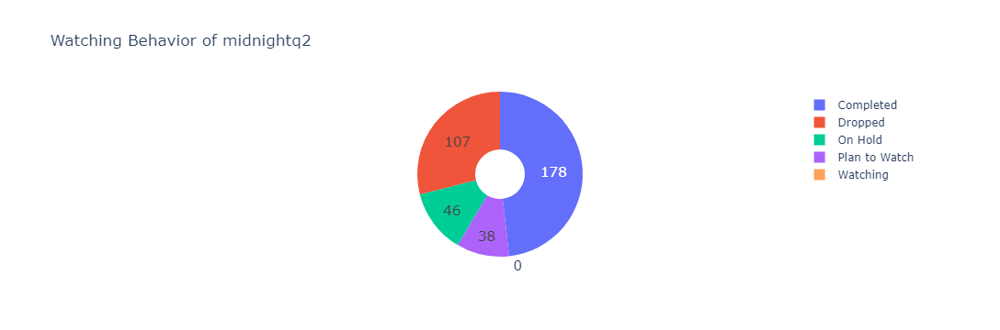

In [48]:
# Function to get watching behavior of a specific user
def get_watching_behavior(username):
    user_data = df_user[df_user['Username'] == username]
    if len(user_data) == 0:
        return None
    watching = user_data['Watching'].values[0]
    on_hold = user_data['On Hold'].values[0]
    completed = user_data['Completed'].values[0]
    dropped = user_data['Dropped'].values[0]
    plan_to_watch = user_data['Plan to Watch'].values[0]
    return watching, on_hold, completed, dropped, plan_to_watch

# Get the input username from the user
username_input = "midnightq2"                           #  input("Enter the username: ")

# Get the watching behavior of the user
watching, on_hold, completed, dropped, plan_to_watch = get_watching_behavior(username_input)

# Create the pie chart
fig = go.Figure(data=[go.Pie(labels=['Watching', 'On Hold', 'Completed', 'Dropped', 'Plan to Watch'],
                             values=[watching, on_hold, completed, dropped, plan_to_watch],
                             hole=0.3,
                             hoverinfo='label+percent',
                             textinfo='value',
                             textfont_size=15)])

# Customize the layout
fig.update_layout(title=f"Watching Behavior of {username_input}",
                  showlegend=True,
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)')

# Show the plot
fig.show()

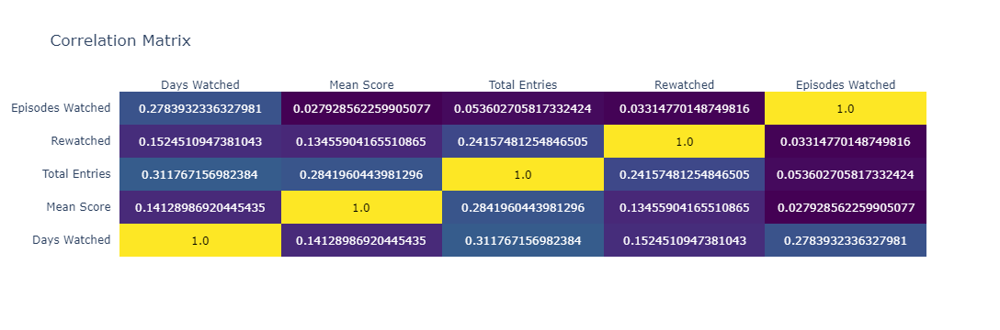

In [49]:
# Create a correlation matrix
correlation_matrix = df_user[['Days Watched', 'Mean Score', 'Total Entries', 'Rewatched', 'Episodes Watched']].corr()

# Create a heatmap of the correlation matrix
fig = ff.create_annotated_heatmap(z=correlation_matrix.values,
                                  x=list(correlation_matrix.columns),
                                  y=list(correlation_matrix.index),
                                  colorscale='Viridis')
fig.update_layout(title='Correlation Matrix')
fig.show()

### For User Score Dataset

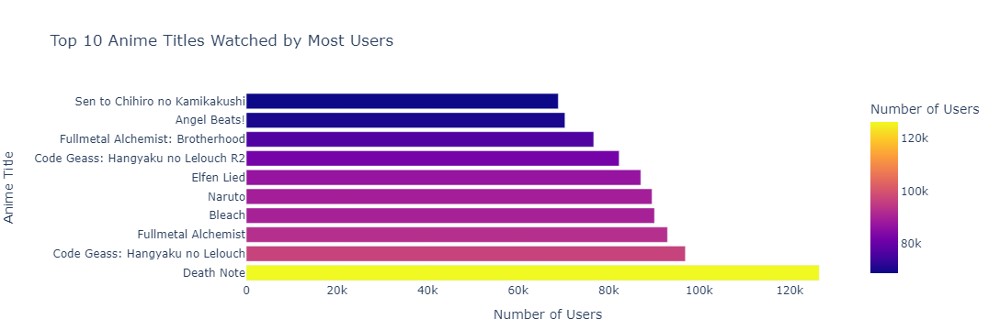

In [50]:
# Animes that was watched by most users in the df_score dataset

# Get the count of users who watched each anime title
anime_watch_count = df_score.groupby('Anime Title')['user_id'].nunique().reset_index()
anime_watch_count = anime_watch_count.rename(columns={'user_id': 'User Count'})

# Sort the dataframe in descending order by the number of users
anime_watch_count = anime_watch_count.sort_values(by='User Count', ascending=False)

# Select the top 10 anime titles with the highest number of users
top_n = 10
top_anime_watch_count = anime_watch_count.head(top_n)

# Define a colorful color palette
color_palette = px.colors.qualitative.Plotly

# Create the bar chart with colorful bars
fig = px.bar(top_anime_watch_count, x='User Count', y='Anime Title', orientation='h',
             title=f'Top {top_n} Anime Titles Watched by Most Users',
             labels={'User Count': 'Number of Users', 'Anime Title': 'Anime Title'},
             color='User Count',
             color_discrete_sequence=color_palette)

# Customize the layout
fig.update_layout(showlegend=False, paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(0,0,0,0)',
                  margin=dict(l=50, r=20, t=100, b=50))

# Show the plot
fig.show()

In [ ]:
!pip install wordcloud -q

In [1]:
### Basic libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import pickle
import warnings
warnings.filterwarnings(action='ignore')

# Data Preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder

# Model Training
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import tensorflow as tf

## Import necessary modules for collaborative filtering
from tensorflow.keras.layers import Input, Embedding, Dot, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from wordcloud import WordCloud
from collections import defaultdict
from collections import Counter

## Import necessary modules for content-based filtering
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import linear_kernel

SyntaxError: invalid syntax (1882645984.py, line 1)

In [2]:
# Load the dataset
df=pd.read_csv('users-score-2023.csv', usecols=["user_id","anime_id","rating"])
print("Shape of the Dataset:",df.shape)
df.head()

Shape of the Dataset: (24325191, 3)


,user_id,anime_id,rating
0,1,21,9
1,1,48,7
2,1,320,5
3,1,49,8
4,1,304,8


In [3]:
# Checking if there are any duplicate rows
duplicated_rows = df[df.duplicated()]
print("Duplicated Rows:")
print(duplicated_rows)

Duplicated Rows:
Empty DataFrame
Columns: [user_id, anime_id, rating]
Index: []


In [4]:
# Calculating the average score
avg_score = np.mean(df['rating'])
print('Average Score:', avg_score)

Average Score: 7.622930072779285


# Data Preprocessing

In [5]:
# Scaling our "rating" column
# Create a MinMaxScaler object
scaler = MinMaxScaler(feature_range=(0, 1))

# Scale the 'score' column between 0 and 1
df['scaled_score'] = scaler.fit_transform(df[['rating']])

In [6]:
# Encoding categorical data

## Encoding user IDs
user_encoder = LabelEncoder()
df["user_encoded"] = user_encoder.fit_transform(df["user_id"])
num_users = len(user_encoder.classes_)

## Encoding anime IDs
anime_encoder = LabelEncoder()
df["anime_encoded"] = anime_encoder.fit_transform(df["anime_id"])
num_animes = len(anime_encoder.classes_)

# Printing dataset information
print("Number of unique users: {}, Number of unique anime: {}".format(num_users, num_animes))
print("Minimum rating: {}, Maximum rating: {}".format(min(df['rating']), max(df['rating'])))

Number of unique users: 270033, Number of unique anime: 16500
Minimum rating: 1, Maximum rating: 10


# Model training (collaborative filtering)

In [7]:
# Shuffle the dataset
df = shuffle(df, random_state=100)

# Create feature matrix X and target variable y
X = df[['user_encoded', 'anime_encoded']].values
y = df["scaled_score"].values

# Printing dataset information
print("Shape of X:", X.shape)
print("Shape of y:", y.shape)

Shape of X: (24325191, 2)
Shape of y: (24325191,)


In [8]:
test_set_size = 10000  # Number of samples to include in the test set

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_set_size, random_state=73)

print("Number of samples in the training set:", len(y_train))
print("Number of samples in the test set:", len(y_test))

Number of samples in the training set: 24315191
Number of samples in the test set: 10000


In [10]:
# Prepare input data for model training and evaluation
X_train_array = [X_train[:, 0], X_train[:, 1]]
X_test_array = [X_test[:, 0], X_test[:, 1]]

In [ ]:
# Setting TPU_INIT flag
USE_TPU = True

# Checking if TPU is initialized
if USE_TPU:
    # If tpu is connected then start creating TPUStrategy
    tpu_resolver = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
    tpu_strategy = tf.distribute.TPUStrategy(tpu_resolver)
else:
    !nvidia-smi
    
# Print the TensorFlow version
tf_version = tf.__version__
print(f"TensorFlow version: {tf_version}")

In [ ]:
def RecommenderNet(num_users, num_animes, embedding_size=128):
    # User input layer and embedding layer
    user = Input(name='user_encoded', shape=[1])
    user_embedding = Embedding(name='user_embedding', input_dim=num_users, output_dim=embedding_size)(user)
    
    # Anime input layer and embedding layer
    anime = Input(name='anime_encoded', shape=[1])
    anime_embedding = Embedding(name='anime_embedding', input_dim=num_animes, output_dim=embedding_size)(anime)
    
    # Dot product of user and anime embeddings
    dot_product = Dot(name='dot_product', normalize=True, axes=2)([user_embedding, anime_embedding])
    flattened = Flatten()(dot_product)
    
    # Dense layers for prediction
    dense = Dense(64, activation='relu')(flattened)
    output = Dense(1, activation='sigmoid')(dense)
    
    # Create and compile the model
    model = Model(inputs=[user, anime], outputs=output)
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.001), metrics=["mae", "mse"])
    
    return model
# Checking if TPU is initialized and create the model accordingly
if USE_TPU:
    with tpu_strategy.scope():
        model = RecommenderNet(num_users, num_animes)
else:
    model = RecommenderNet(num_users, num_animes)

# Printing my model summary
model.summary()

In [ ]:
## Import necessary callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler, EarlyStopping

start_lr = 0.00001
min_lr = 0.00001
max_lr = 0.00005
batch_size = 10000

# Adjust the maximum learning rate and batch size if using TPU
if USE_TPU:
    max_lr = max_lr * tpu_strategy.num_replicas_in_sync
    batch_size = batch_size * tpu_strategy.num_replicas_in_sync

# Define the number of epochs for ramp-up, sustain, and exponential decay
rampup_epochs = 5
sustain_epochs = 0
exp_decay = .8

# Learning rate schedule function
def lrfn(epoch):
    if epoch < rampup_epochs:
        return (max_lr - start_lr) / rampup_epochs * epoch + start_lr
    elif epoch < rampup_epochs + sustain_epochs:
        return max_lr
    else:
        return (max_lr - min_lr) * exp_decay**(epoch - rampup_epochs - sustain_epochs) + min_lr

# Learning rate scheduler callback
lr_callback = LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=0)

# File path for saving the model weights
checkpoint_filepath = 'myanimeweights.h5'

# Model checkpoint callback to save the best weights
model_checkpoints = ModelCheckpoint(filepath=checkpoint_filepath,
                                    save_weights_only=True,
                                    monitor='val_loss',
                                    mode='min',
                                    save_best_only=True)

# Early stopping callback to prevent overfitting
early_stopping = EarlyStopping(patience=3, monitor='val_loss', mode='min', restore_best_weights=True)

# Define the list of callbacks
my_callbacks = [
    model_checkpoints,
    lr_callback,
    early_stopping
]

In [ ]:
# Model training
history = model.fit(
    x=X_train_array,
    y=y_train,
    batch_size=batch_size,
    epochs=20,
    verbose=1,
    validation_data=(X_test_array, y_test),
    callbacks=my_callbacks
)

model.load_weights(checkpoint_filepath)

In [ ]:
# Training results visualization

plt.plot(history.history["loss"][0:-2])
plt.plot(history.history["val_loss"][0:-2])
plt.title("Training Loss")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.legend(["Train", "Validation"], loc="upper left")
plt.show()

# Recommendation:

In [ ]:
def extract_weights(name, model):
    # Get the layer by name from the model
    weight_layer = model.get_layer(name)
    
    # Get the weights from the layer
    weights = weight_layer.get_weights()[0]
    
    # Normalize the weights
    weights = weights / np.linalg.norm(weights, axis=1).reshape((-1, 1))
    
    return weights

# Extract weights for anime embeddings
anime_weights = extract_weights('anime_embedding', model)
# Extract weights for user embeddings
user_weights = extract_weights('user_embedding', model)

#### Reading the whole dataset

In [ ]:
df_anime=pd.read_csv('anime-dataset-2023.csv')

#### Now I want my model to recommend only those animes that have been rated by at least a certain number of users, which I will set as the threshold. This threshold helps ensure that the recommended anime titles have received a sufficient number of ratings, indicating a certain level of popularity or user engagement.

In [ ]:
popularity_threshold = 50
df_anime= df_anime.query('Members >= @popularity_threshold')
print(df_anime.shape)
df_anime.head(3)      # only give rating of those movies for which atleast 200 user have rated

# 1: Item Based Recommendation

In [ ]:
def find_similar_animes(name, n=10, return_dist=False, neg=False):
    try:
        anime_row = df_anime[df_anime['Name'] == name].iloc[0]
        index = anime_row['anime_id']
        encoded_index = anime_encoder.transform([index])[0]
        weights = anime_weights
        dists = np.dot(weights, weights[encoded_index])
        sorted_dists = np.argsort(dists)
        n = n + 1            
        if neg:
            closest = sorted_dists[:n]
        else:
            closest = sorted_dists[-n:]
        print('Animes closest to {}'.format(name))
        if return_dist:
            return dists, closest
        
        SimilarityArr = []
        
        for close in closest:
            decoded_id = anime_encoder.inverse_transform([close])[0]
            anime_frame = df_anime[df_anime['anime_id'] == decoded_id]
            
            anime_name = anime_frame['Name'].values[0]
            english_name = anime_frame['English name'].values[0]
            name = english_name if english_name != "UNKNOWN" else anime_name
            genre = anime_frame['Genres'].values[0]
            Synopsis = anime_frame['Synopsis'].values[0]
            similarity = dists[close]
            similarity = "{:.2f}%".format(similarity * 100)
            SimilarityArr.append({"Name": name, "Similarity": similarity, "Genres": genre, "Synopsis":Synopsis})
        Frame = pd.DataFrame(SimilarityArr).sort_values(by="Similarity", ascending=False)
        return Frame[Frame.Name != name]
    except:
        print('{} not found in Anime list'.format(name))

pd.set_option('display.max_colwidth', None)

In [ ]:
find_similar_animes('Tensei shitara Slime Datta Ken', n=5, neg=False)  # That Time I Got Reincarnated as a Slime

In [ ]:
find_similar_animes('Shigatsu wa Kimi no Uso', n=5, neg=False) # Your Lie in April

In [ ]:
find_similar_animes('One Punch Man', n=5, neg=False)

In [ ]:
find_similar_animes('Mushoku Tensei: Isekai Ittara Honki Dasu', n=5, neg=False)

# 2: User Based Recommendation
#### (The user-based recommendation system is divided into three parts:)

## Part 1: Finding Similar Users
#### In this part, we randomly select a user from the dataset and find similar users based on their anime preferences. The find_similar_users function calculates the similarity between users using a weighted matrix and returns a dataframe of similar users. The function takes an input user, number of similar users to find (n), and other optional parameters. The result is a list of similar users to the input user.

In [ ]:
def find_similar_users(item_input, n=10, return_dist=False, neg=False):
    try:
        index = item_input
        encoded_index = user_encoder.transform([index])[0]
        weights = user_weights
        dists = np.dot(weights, weights[encoded_index])
        sorted_dists = np.argsort(dists)
        n = n + 1
        
        if neg:
            closest = sorted_dists[:n]
        else:
            closest = sorted_dists[-n:]
            
        SimilarityArr = []
        
        for close in closest:
            similarity = dists[close]
            if isinstance(item_input, int):
                decoded_id = user_encoder.inverse_transform([close])[0]
                SimilarityArr.append({"similar_users": decoded_id, "similarity": similarity})
        Frame = pd.DataFrame(SimilarityArr).sort_values(by="similarity", ascending=False)
        return Frame
    except:
        print('\033[1m{}\033[0m, Not Found in User list'.format(item_input))

In [ ]:
# Select a random user
ratings_per_user = df.groupby('user_id').size()
random_user = int(ratings_per_user[ratings_per_user < 500].sample(1, random_state=None).index[0])

# Find similar users to the random user
similar_users = find_similar_users(random_user, n=10, neg=False)
similar_users = similar_users[similar_users.similarity > 0.4]
similar_users = similar_users[similar_users.similar_users != random_user]
similar_users

## Part 2: User Preferences
#### This part focuses on understanding the preferences of the selected user. The get_user_preferences function takes a user ID as input and retrieves the anime preferences of that user. It considers the top-rated animes by the user and analyzes the genres they prefer. The function also provides an option to plot a word cloud to visualize the preferred genres. The output is a dataframe containing the anime titles and their associated genres.

In [ ]:
# Function to display a word cloud of preferred genres
def showWordCloud(all_genres):
    genres_cloud = WordCloud(width=700, height=400, background_color='white', colormap='gnuplot').generate_from_frequencies(all_genres)
    plt.figure(figsize=(10, 8))
    plt.imshow(genres_cloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

def get_user_preferences(user_id, plot=False, verbose=0):
    animes_watched_by_user = df[df['user_id'] == user_id]
    
    if animes_watched_by_user.empty:
        print("User #{} has not watched any animes.".format(user_id))
        return pd.DataFrame()
    
    user_rating_percentile = np.percentile(animes_watched_by_user.rating, 75)
    animes_watched_by_user = animes_watched_by_user[animes_watched_by_user.rating >= user_rating_percentile]
    top_animes_user = (
        animes_watched_by_user.sort_values(by="rating", ascending=False)
        .anime_id.values
    )
    
    anime_df_rows = df_anime[df_anime["anime_id"].isin(top_animes_user)]
    anime_df_rows = anime_df_rows[["Name", "Genres"]]
    
    if verbose != 0:
        print("User \033[1m{}\033[0m has watched {} anime(s) with an average rating of {:.1f}/10\n".format(
            user_id, len(animes_watched_by_user), animes_watched_by_user['rating'].mean()
        ))
        print('\033[1m----- Preferred genres----- \033[0m\n')

    if plot:
        genres_list = []
        for genres in anime_df_rows['Genres']:
            if isinstance(genres, str):
                for genre in genres.split(','):
                    genres_list.append(genre.strip())

        showWordCloud(dict(Counter(genres_list)))
    
    return anime_df_rows

In [ ]:
# Get user preferences for the random user
user_pref = get_user_preferences(random_user, plot=True, verbose=1)
pd.DataFrame(user_pref).head(5)

## Part 3: Recommending Animes for a User
#### In the final part, we recommend animes to the selected user based on the preferences of similar users. The get_recommended_animes function iterates through the list of similar users, retrieves their preferences, and identifies animes that are not present in the preferences of the selected user. It then generates a list of recommended animes along with their genres and a brief synopsis. The output is a dataframe containing the recommended animes for the user.

In [ ]:
def get_recommended_animes(similar_users, user_pref, n=10):
    recommended_animes = []
    anime_list = []
    
    for user_id in similar_users.similar_users.values:
        pref_list = get_user_preferences(int(user_id))
        if not pref_list.empty:  # Check if user has watched any animes
            pref_list = pref_list[~pref_list["Name"].isin(user_pref["Name"].values)]
            anime_list.append(pref_list.Name.values)
            
    if len(anime_list) == 0:
        print("No anime recommendations available for the given users.")
        return pd.DataFrame()
    
    anime_list = pd.DataFrame(anime_list)
    sorted_list = pd.DataFrame(pd.Series(anime_list.values.ravel()).value_counts()).head(n)
    # Count the occurrences of each anime in the entire dataset
    anime_count = df['anime_id'].value_counts()
    
    for i, anime_name in enumerate(sorted_list.index):
        if isinstance(anime_name, str):
            try:
                anime_id = df_anime[df_anime.Name == anime_name].anime_id.values[0]
                english_name = df_anime[df_anime['Name'] == anime_name]['English name'].values[0]
                name = english_name if english_name != "UNKNOWN" else anime_name
                genre = df_anime[df_anime.Name == anime_name].Genres.values[0]
                Synopsis = df_anime[df_anime.Name == anime_name].Synopsis.values[0]
                n_user_pref = anime_count.get(anime_id, 0)  # Get the total count of users who have watched this anime
                recommended_animes.append({
                    "n": n_user_pref,
                    "anime_name": anime_name, 
                    "Genres": genre, 
                    "Synopsis": Synopsis
                })
            except:
                pass
    return pd.DataFrame(recommended_animes)

In [ ]:
# Get recommended animes for the random user
recommended_animes = get_recommended_animes(similar_users, user_pref, n=10)

print('\n> Top recommendations for user: {}'.format(random_user))
recommended_animes

# Model training (content-based filtering)

In [ ]:
# Create a TF-IDF vectorizer
tfidf = TfidfVectorizer(stop_words='english')

# Define a generator to compute TF-IDF matrix on the fly
tfidf_matrix_generator = tfidf.fit_transform((genre for genre in df_anime['Genres'].values.astype('U')))

# Compute cosine similarity matrix as a sparse matrix
cosine_sim_sparse = linear_kernel(tfidf_matrix_generator, tfidf_matrix_generator)

# 2: Content-Based Recommendation

In [ ]:
# Function to get recommendations based on cosine similarity, genre, and ratings based on score
def get_recommendations(title, cosine_sim, df):
    idx = df_anime[df_anime['Name'] == title].index[0]

    # Compute the similarity scores between the anime at the given index and all other animes
    sim_scores = list(enumerate(cosine_sim[idx]))

    # Filter out animes with unknown scores
    valid_scores = [x for x in sim_scores if df_anime.iloc[x[0]]['Score'] != "UNKNOWN"]

    # Sort the valid anime similarity scores based on the cosine similarity and ratings score in descending order
    sorted_scores = sorted(valid_scores, key=lambda x: (x[1], df_anime.iloc[x[0]]['Score']), reverse=True)

    # Get the top 10 similar animes (excluding the anime itself)
    top_animes = [x for x in sorted_scores if x[0] != idx][:10]

    # Extract the indices of the recommended animes
    recommended_indices = [idx for idx, _ in top_animes]
    recommended_animes = df_anime.iloc[recommended_indices][['Name', 'Genres', 'Score']]
    return recommended_animes

In [ ]:
# Example usage: Get recommendations for an anime
anime_title = 'Kono Subarashii Sekai ni Shukufuku wo!'
recommendations = get_recommendations(anime_title, cosine_sim_sparse, df_anime)
print(f'Recommendations for "{anime_title}":')
recommendations

In [ ]:
anime_title = 'One Piece'
recommendations = get_recommendations(anime_title, cosine_sim_sparse, df_anime)
print(f'Recommendations for "{anime_title}":')
recommendations

In [ ]:
def get_recommendations(cosine_sim, df):
    
    unique_genres = set()
    for genres in df_anime['Genres'].dropna().unique():
        unique_genres.update(genre.strip() for genre in genres.split(','))
    print("Available genres:", ", ".join(sorted(unique_genres)))
    choice = input("Enter 'title' to recommend based on a specific anime or 'genre' for genre-based recommendation: ").lower()
    if choice == 'title':
        title = input("Enter the anime title: ")
        idx = df_anime[df_anime['Name'] == title].index[0]
        sim_scores = list(enumerate(cosine_sim[idx]))
        valid_scores = [x for x in sim_scores if df.iloc[x[0]]['Score'] != "UNKNOWN"]
        sorted_scores = sorted(valid_scores, key=lambda x: (x[1], df_anime.iloc[x[0]]['Score']), reverse=True)
        top_animes = [x for x in sorted_scores if x[0] != idx][:10]
        recommended_indices = [idx for idx, _ in top_animes]
        recommended_animes = df_anime.iloc[recommended_indices][['Name', 'Genres', 'Score']]
        return recommended_animes

    elif choice == 'genre':
        genres = input("Enter a list of genres separated by commas: ").split(',')
        genres = [genre.strip().lower() for genre in genres]  # Clean and normalize input
        genre_filtered_df = df_anime[df_anime['Genres'].apply(lambda x: any(genre in x.lower() for genre in genres))]
        top_genre_animes = genre_filtered_df.sort_values(by='Score', ascending=False).head(10)
        return top_genre_animes
    else:
        return "Invalid choice. Please enter 'title' or 'genre'."